## Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [3]:
import numpy as np
import pandas as pd
import pickle as pkl
from datetime import datetime
from dateutil import parser

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline
plt.rcParams['figure.figsize'] = (12.0, 8.0)
plt.rcParams['axes.axisbelow'] = True

from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go
import plotly.io as pio
init_notebook_mode(True)

from hallprobecalib import hpc_ext_path
from hallprobecalib.hpcplots import scatter2d,scatter3d,histo

## Day 1: Cleaning, Plots

In [4]:
plotdir = hpc_ext_path+'plots/magnet_stability/2019-06-12/'

In [5]:
directory = hpc_ext_path+'datafiles/magnet_stability/nmr/'
#filename = '2019-06-12 115902slow.txt'
filename = '2019-06-12 115902slow_fixed.csv' #header error

In [6]:
df = pd.read_csv(directory+filename)

df.describe()

,Magnet Current [V],Magnet Voltage [V],Coil 1 (new),Coil 2 (old),LCW in Coil1,LCW out Coil 1,LCW in Coil 2,LCW out Coil 2,Yoke,Hall Element,...,LCW from PS,LCW to magnet,NMR [T],NMR [FFT],Zaber_Meas_MicroStep_X,Zaber_Meas_Encoder_X,Zaber_Meas_MicroStep_Y,Zaber_Meas_Encoder_Y,Zaber_Meas_MicroStep_Z,Zaber_Meas_Encoder_Z
count,1634.000000,1634.000000,1634.000000,1634.000000,1634.000000,1634.000000,1634.000000,1634.000000,1634.000000,1634.000000,...,1634.000000,1634.000000,1634.000000,1634.0,1634.0000,1634.0,1634.00,1634.0,1634.000,1634.0
mean,8.468734,38.380391,57.673437,54.014756,25.447499,29.326364,29.135225,34.593984,28.105064,22.505136,...,30.494380,25.538782,1.317133,0.0,210351.5625,538500.0,178906.25,458000.0,642578.125,1645000.0
std,0.166859,0.974054,0.288601,0.285039,0.287615,0.293171,0.271249,0.294100,0.156657,0.160455,...,0.265402,0.295458,0.046123,0.0,0.0000,0.0,0.00,0.0,0.000,0.0
min,1.727947,-0.934970,57.032902,53.226047,24.889301,28.764173,28.550444,34.025940,27.728804,22.001955,...,29.851265,24.929380,0.000000,0.0,210351.5625,538500.0,178906.25,458000.0,642578.125,1645000.0
25%,8.472857,38.369971,57.419657,53.803022,25.196060,29.069161,28.889896,34.335103,27.973823,22.395055,...,30.334456,25.294626,1.318731,0.0,210351.5625,538500.0,178906.25,458000.0,642578.125,1645000.0
50%,8.472862,38.424875,57.799318,54.049871,25.599247,29.474822,29.266933,34.742998,28.171774,22.514944,...,30.561986,25.685824,1.318739,0.0,210351.5625,538500.0,178906.25,458000.0,642578.125,1645000.0
75%,8.472866,38.440167,57.912410,54.221602,25.697218,29.580809,29.361213,34.847209,28.232000,22.621478,...,30.732789,25.791604,1.318765,0.0,210351.5625,538500.0,178906.25,458000.0,642578.125,1645000.0
max,8.472876,38.447083,58.092510,54.627819,25.852604,29.651625,29.499653,34.933346,28.283024,23.174345,...,30.918554,26.026777,1.318797,0.0,210351.5625,538500.0,178906.25,458000.0,642578.125,1645000.0


In [7]:
df2 = df[df[" NMR [T]"] >0.]

In [8]:
fig = histo(df[' NMR [T]'],bins=25,inline=True);
fig = histo(df2[' NMR [T]'],bins=45,inline=True);

In [9]:
fname = 'hist_NMR'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-12/hist_NMR.html'

In [12]:
dates = [parser.parse(row.Time) for row in df.itertuples()]# if isdatetime(row.Time.values[0])]

- NOTE: 'as.type("str")' is necessary to ensure plotly doesn't convert datetime to UTC!

In [13]:
df["Datetime"] = pd.to_datetime(dates).astype("str")
df = df.set_index("Datetime")

In [14]:
df

,Time,Magnet Current [V],Magnet Voltage [V],Coil 1 (new),Coil 2 (old),LCW in Coil1,LCW out Coil 1,LCW in Coil 2,LCW out Coil 2,Yoke,...,LCW from PS,LCW to magnet,NMR [T],NMR [FFT],Zaber_Meas_MicroStep_X,Zaber_Meas_Encoder_X,Zaber_Meas_MicroStep_Y,Zaber_Meas_Encoder_Y,Zaber_Meas_MicroStep_Z,Zaber_Meas_Encoder_Z
Datetime,,,,,,,,,,,,,,,,,,,,,
2019-06-12 11:59:47,6/12/2019 11:59:47 AM,8.472865,38.401967,57.647392,53.981808,25.496454,29.360390,29.204119,34.616898,28.170130,...,30.380722,25.583807,1.318736,0,210351.5625,538500,178906.25,458000,642578.125,1645000
2019-06-12 12:00:48,6/12/2019 12:00:48 PM,8.472867,38.402650,57.626717,53.887226,25.486916,29.382366,29.113739,34.626186,28.154757,...,30.419033,25.592028,1.318736,0,210351.5625,538500,178906.25,458000,642578.125,1645000
2019-06-12 12:01:48,6/12/2019 12:01:48 PM,8.472864,38.403367,57.703854,53.800777,25.485971,29.387053,29.200180,34.613823,28.177610,...,30.428804,25.594919,1.318736,0,210351.5625,538500,178906.25,458000,642578.125,1645000
2019-06-12 12:02:47,6/12/2019 12:02:47 PM,8.472864,38.404000,57.668560,53.830296,25.483866,29.379570,29.139357,34.633247,28.165150,...,30.427898,25.595333,1.318737,0,210351.5625,538500,178906.25,458000,642578.125,1645000
2019-06-12 12:03:48,6/12/2019 12:03:48 PM,8.472864,38.404600,57.733444,53.941223,25.489433,29.382996,29.186457,34.611710,28.161804,...,30.400301,25.599895,1.318737,0,210351.5625,538500,178906.25,458000,642578.125,1645000
2019-06-12 12:04:47,6/12/2019 12:04:47 PM,8.472864,38.405217,57.686592,53.851322,25.496180,29.391109,29.205202,34.638969,28.167629,...,30.412178,25.598166,1.318737,0,210351.5625,538500,178906.25,458000,642578.125,1645000
2019-06-12 12:05:48,6/12/2019 12:05:48 PM,8.472865,38.405850,57.635296,53.875103,25.493622,29.393040,29.232140,34.673286,28.156036,...,30.407707,25.600231,1.318737,0,210351.5625,538500,178906.25,458000,642578.125,1645000
2019-06-12 12:06:48,6/12/2019 12:06:48 PM,8.472863,38.406317,57.670071,53.841183,25.504322,29.393040,29.220503,34.601948,28.165169,...,30.436171,25.609850,1.318737,0,210351.5625,538500,178906.25,458000,642578.125,1645000
2019-06-12 12:07:47,6/12/2019 12:07:47 PM,8.472863,38.406867,57.688919,53.926681,25.505896,29.395363,29.156605,34.640034,28.158417,...,30.417320,25.606152,1.318737,0,210351.5625,538500,178906.25,458000,642578.125,1645000


In [15]:
df2 = df[df[" NMR [T]"] >0.]

In [16]:
d = df.index[[1]]
d[0]

'2019-06-12 12:00:48'

Turns out the zero NMR measurements are right as the program is stopping.

In [17]:
fig = scatter2d(df.index,df[" NMR [T]"],lines=True,markers=False,size_list=[6],inline=True)
#fig = scatter2d(df2.index,df2[" NMR [T]"],lines=True,markers=False,size_list=[6],inline=True)

So we'll just replace df with df2.

In [18]:
df = df2

CORRELATION FIT FOR COMPARISON TO RUN 2

In [22]:
df["ind"] = np.array([i for i in range(len(df))])

In [23]:
def color_scatter2d(x,y,ind,time=df.index,show_plot=True):
    data = [
        go.Scatter(
            x=x,
            y=y,
            marker=dict(
                size=2,
                cmax=ind.max(),
                cmin=ind.min(),
                color=ind,
                colorbar=dict(
                    title='time (index)',
                    #ticktext=df.index
                ),
                colorscale='Viridis',
            ),
            mode='markers',
            text=time,
        )
    ]
    
    layout = go.Layout(
        title = f"{y.name} vs. {x.name}",
        xaxis = dict(
            title = f"{x.name}"
        ),
        yaxis = dict(
            title = f"{y.name}"
        ),
    )

    fig = go.Figure(data=data,layout=layout)
    if show_plot:
        iplot(fig)
    return fig

In [24]:
for col in df.columns:
    fig = color_scatter2d(df[col],df[" NMR [T]"],df.ind,show_plot=False);
    pio.write_image(fig,plotdir+f"nmr_correlations/{col}_vs_nmr.pdf")
    pio.write_image(fig,plotdir+f"nmr_correlations/{col}_vs_nmr.png")

In [19]:
from scipy import stats

In [25]:
corr_main = " Yoke"
#slope, intercept, r_value, p_value, std_err = stats.linregress(df[" Yoke"], df[" NMR [T]"])
slope, intercept, r_value, p_value, std_err = stats.linregress(df[corr_main], df[" NMR [T]"])

In [26]:
slope, intercept, r_value, p_value, std_err

(-0.00013457087368655657,
 1.322529769525168,
 -0.9962006354616783,
 0.0,
 2.913855644743552e-07)

In [27]:
line = slope * df[corr_main] + intercept

In [28]:
fig = scatter2d(2*[df[corr_main]],[df[" NMR [T]"],line],lines=False,markers=True,size_list=[2,2],inline=True)

In [29]:
pio.write_image(fig,plotdir+f"yoke_vs_nmr_fit.pdf")
pio.write_image(fig,plotdir+f"yoke_vs_nmr_fit.png")

In [30]:
df["NMR_const"] = df[" NMR [T]"] - slope * df[corr_main] - intercept + df[" NMR [T]"].mean()

In [31]:
fig = scatter2d(2*[df[corr_main]],[df["NMR_const"],line],lines=False,markers=True,size_list=[2,2],inline=True)

In [32]:
pio.write_image(fig,plotdir+f"yoke_vs_nmr_fit_subtract.pdf")
pio.write_image(fig,plotdir+f"yoke_vs_nmr_fit_subtract.png")

In [33]:
fig = histo(df[" NMR [T]"],bins=50,inline=True);
fig = histo(df["NMR_const"],bins=50,inline=True);
pio.write_image(fig,plotdir+f"yoke_correction_nmr_hist.pdf")
pio.write_image(fig,plotdir+f"yoke_correction_nmr_hist.png")

In [ ]:
#for col in df.columns:
#    fig = color_scatter2d(df[col],df[" NMR [T]"],df.ind,show_plot=False);
#    pio.write_image(fig,plotdir+f"nmr_correlations/{col}_vs_nmr.pdf")
#    pio.write_image(fig,plotdir+f"nmr_correlations/{col}_vs_nmr.png")

In [36]:
for col in df.columns:
    fig = color_scatter2d(df[col],df["NMR_const"],df.ind,show_plot=False);
    pio.write_image(fig,plotdir+f"nmr_const_correlations/{col}_vs_nmr.pdf")
    pio.write_image(fig,plotdir+f"nmr_const_correlations/{col}_vs_nmr.png")

In [277]:
df[" NMR [T]"].max()-df[" NMR [T]"].min()

7.079799999987202e-05

In [279]:
df[df[" NMR [T]"] == df[" NMR [T]"].min()]

,Time,Magnet Current [V],Magnet Voltage [V],Coil 1 (new),Coil 2 (old),LCW in Coil1,LCW out Coil 1,LCW in Coil 2,LCW out Coil 2,Yoke,...,LCW from PS,LCW to magnet,NMR [T],NMR [FFT],Zaber_Meas_MicroStep_X,Zaber_Meas_Encoder_X,Zaber_Meas_MicroStep_Y,Zaber_Meas_Encoder_Y,Zaber_Meas_MicroStep_Z,Zaber_Meas_Encoder_Z
Datetime,,,,,,,,,,,,,,,,,,,,,
2019-06-12 19:48:48,6/12/2019 7:48:48 PM,8.472861,38.441283,58.059517,54.444469,25.696535,29.569681,29.385931,34.855099,28.241901,...,30.731047,25.781847,1.318727,0,210351.5625,538500,178906.25,458000,642578.125,1645000


In [294]:
time_drift = parser.parse(df.index.max())-parser.parse(df[df[" NMR [T]"] == df[" NMR [T]"].min()].index.values[0])

In [299]:
(time_drift.seconds/60/60, (time_drift.seconds/60/60-time_drift.seconds/60//60)*60)

(19.366944444444446, 22.01666666666675)

In [250]:
nmr =df[' NMR [T]']
(nmr.max() - nmr.min()) / nmr.mean()

5.3685785326602656e-05

In [251]:
pio.write_image(fig, plotdir+'NMR_vs_Time.pdf')
pio.write_image(fig, plotdir+'NMR_vs_Time.png')
plot(fig, filename=plotdir+'NMR_vs_Time.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-12/NMR_vs_Time.html'

In [237]:
df.columns

Index(['Time', ' Magnet Current [V]', ' Magnet Voltage [V]', 'Coil 1 (new)',
       ' Coil 2 (old)', ' LCW in Coil1', ' LCW out Coil 1', ' LCW in Coil 2',
       ' LCW out Coil 2', ' Yoke', ' Hall Element', ' Floor', ' Roof',
       'Parameter HVAC return', ' Parameter HVAC sensor', ' CH13', ' CH14',
       ' CH15', ' CH16', ' CH17', ' CH18', ' CH19', ' CH20', 'CH21', ' CH22',
       ' CH23', ' CH24', ' CH25', ' CH26', ' PS internal', ' PS Vent1',
       ' PS Vent2', ' TrippLite HVAC supply', ' Tripplite HVAC exhaust',
       'LCW to PS', ' LCW in barrel', ' ICW in', ' ICW HE1 out',
       ' ICW He2 out', ' LCW return magnet', ' LCW to barrel', ' LCW from PS',
       'LCW to magnet', ' NMR [T]', ' NMR [FFT]', ' Zaber_Meas_MicroStep_X',
       ' Zaber_Meas_Encoder_X', '  Zaber_Meas_MicroStep_Y',
       ' Zaber_Meas_Encoder_Y', '  Zaber_Meas_MicroStep_Z',
       ' Zaber_Meas_Encoder_Z'],
      dtype='object')

In [252]:
temps_ch = [a for a in df.columns if ("CH" in a) and int(a[-2:])<21]# or "HVAC" in a]
temps_ch.append(" Hall Element")
temps_ch.append(" Floor")
temps_ch.append(" Roof")

In [253]:
temps_ch

[' CH13',
 ' CH14',
 ' CH15',
 ' CH16',
 ' CH17',
 ' CH18',
 ' CH19',
 ' CH20',
 ' Hall Element',
 ' Floor',
 ' Roof']

In [254]:
df[temps_ch].describe()

,CH13,CH14,CH15,CH16,CH17,CH18,CH19,CH20,Hall Element,Floor,Roof
count,1632.000000,1632.000000,1632.000000,1632.000000,1632.000000,1632.000000,1632.000000,1632.000000,1632.000000,1632.000000,1632.000000
mean,19.820622,20.641097,20.883382,20.277651,18.788005,18.991837,18.611507,18.242056,22.504542,21.852057,17.614670
std,0.145764,0.147378,0.149177,0.149349,0.148798,0.146502,0.151194,0.142245,0.159522,0.132634,0.129884
min,19.412226,20.284876,20.522924,19.885212,18.398909,18.618904,18.215826,17.899088,22.001955,21.559435,17.320618
25%,19.697847,20.501115,20.740983,20.140525,18.657289,18.860683,18.481342,18.114589,22.394579,21.704250,17.497873
50%,19.861924,20.698326,20.943298,20.333031,18.836576,19.040208,18.655905,18.289810,22.514679,21.901403,17.658810
75%,19.939159,20.764694,21.008483,20.401670,18.911550,19.112850,18.735438,18.357275,22.621168,21.969456,17.722331
max,20.089693,20.857767,21.101809,20.521236,19.040228,19.237314,18.874542,18.477676,22.963053,22.014530,17.843687


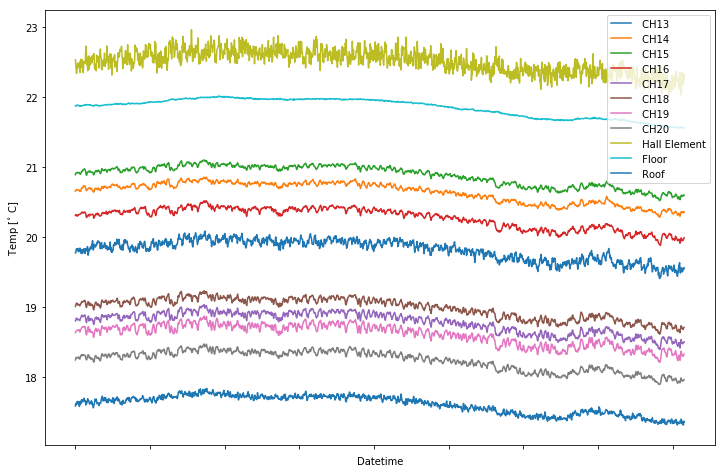

In [255]:
fig = plt.figure()
for c in temps_ch:
    df[c].plot()
#plt.ylabel('Temp [C]')
plt.ylabel("Temp [$^{\circ}$ C]")
plt.legend()    

In [256]:
fig = scatter2d([df.index for c in temps_ch],[df[c] for c in temps_ch],inline=True);
fig.layout.title = "Temp vs. Datetime"
fig.layout.yaxis.title = "Temp [deg. C]"

In [257]:
fname = 'temps_scatter'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-12/temps_scatter.html'

In [300]:
fig = histo([df[c] for c in temps_ch],verbosity=1,inline=True);
fig.layout.title = "Temp Histos"

In [301]:
fig.layout.xaxis.title = "Temp [deg C]"
fname = 'hist_temps'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-12/hist_temps.html'

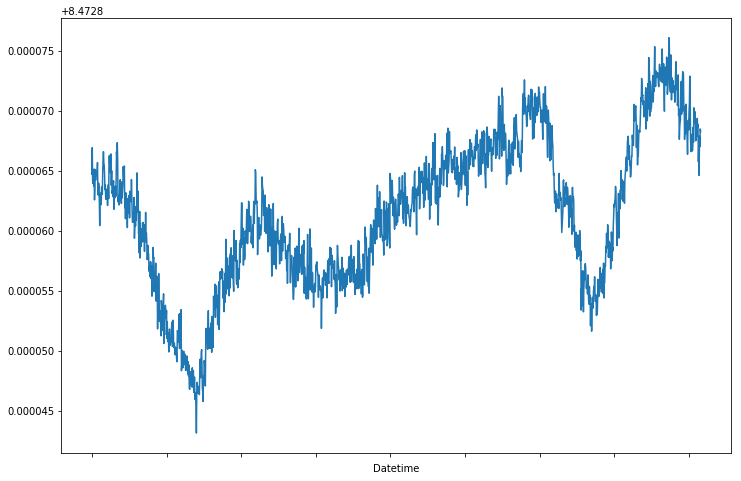

In [260]:
df[' Magnet Current [V]'].plot()

In [261]:
fig = scatter2d(df.index,df[' Magnet Current [V]'],inline=True);

In [262]:
fname = 'magnet_current'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-12/magnet_current.html'

In [264]:
3e-4 /df[" Magnet Current [V]"].mean()

3.540716467310749e-05

In [265]:
fig = scatter2d(df.index,df[' Magnet Voltage [V]'],inline=True);

In [266]:
fname = 'magnet_voltage'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-12/magnet_voltage.html'

In [268]:
fig = scatter2d(df.index,-df[' NMR [T]'],inline=True)

In [269]:
m =df[' Magnet Voltage [V]']
(m.max() - m.min()) / m.mean()

0.0031241989640859347

In [271]:
fig = scatter2d(2*[df.index],[df[" NMR [T]"],df[" NMR [T]"]*df[' Magnet Voltage [V]']/df[' Magnet Voltage [V]'].mean()],lines=False,markers=True,size_list=[6,6],inline=True)

In [272]:
fig = scatter2d(2*[df.index],[df[" NMR [T]"],df[" NMR [T]"]*df[' Magnet Current [V]']/df[' Magnet Current [V]'].mean()],lines=False,markers=True,size_list=[6,6],inline=True)
#fig = scatter2d(2*[df.index],[df[" NMR [T]"],df[" NMR [T]"]*df[' Magnet Current [V]'].mean()/df[' Magnet Current [V]']],lines=False,markers=True,size_list=[6,6],inline=True)

In [273]:
a = df[" NMR [T]"]*df[' Magnet Current [V]']/df[' Magnet Current [V]'].mean()
a.name = "NMR"
histo([a],bins=10,inline=True);

In [274]:
fig = scatter2d(df.index,df[" NMR [T]"],lines=False,markers=True,size_list=[6],inline=True);

In [275]:
df[" NMR [T]"]*df[' Magnet Current [V]'].mean()/df[' Magnet Current [V]']

Datetime
2019-06-12 11:59:47    1.318736
2019-06-12 12:00:48    1.318735
2019-06-12 12:01:48    1.318736
2019-06-12 12:02:47    1.318736
2019-06-12 12:03:48    1.318736
2019-06-12 12:04:47    1.318736
2019-06-12 12:05:48    1.318736
2019-06-12 12:06:48    1.318737
2019-06-12 12:07:47    1.318737
2019-06-12 12:08:48    1.318737
2019-06-12 12:09:48    1.318737
2019-06-12 12:10:47    1.318737
2019-06-12 12:11:48    1.318737
2019-06-12 12:12:48    1.318738
2019-06-12 12:13:47    1.318737
2019-06-12 12:14:48    1.318737
2019-06-12 12:15:48    1.318738
2019-06-12 12:16:47    1.318738
2019-06-12 12:17:48    1.318738
2019-06-12 12:18:47    1.318738
2019-06-12 12:19:47    1.318738
2019-06-12 12:20:48    1.318739
2019-06-12 12:21:47    1.318738
2019-06-12 12:22:48    1.318739
2019-06-12 12:23:48    1.318739
2019-06-12 12:24:47    1.318739
2019-06-12 12:25:48    1.318739
2019-06-12 12:26:48    1.318739
2019-06-12 12:27:47    1.318739
2019-06-12 12:28:48    1.318738
                         ...   

In [276]:
for col in df.columns:
    fig = scatter2d(df.index,df[col],lines=True,markers=False,size_list=[6],inline=True); 

In [302]:
df.columns

Index(['Time', ' Magnet Current [V]', ' Magnet Voltage [V]', 'Coil 1 (new)',
       ' Coil 2 (old)', ' LCW in Coil1', ' LCW out Coil 1', ' LCW in Coil 2',
       ' LCW out Coil 2', ' Yoke', ' Hall Element', ' Floor', ' Roof',
       'Parameter HVAC return', ' Parameter HVAC sensor', ' CH13', ' CH14',
       ' CH15', ' CH16', ' CH17', ' CH18', ' CH19', ' CH20', 'CH21', ' CH22',
       ' CH23', ' CH24', ' CH25', ' CH26', ' PS internal', ' PS Vent1',
       ' PS Vent2', ' TrippLite HVAC supply', ' Tripplite HVAC exhaust',
       'LCW to PS', ' LCW in barrel', ' ICW in', ' ICW HE1 out',
       ' ICW He2 out', ' LCW return magnet', ' LCW to barrel', ' LCW from PS',
       'LCW to magnet', ' NMR [T]', ' NMR [FFT]', ' Zaber_Meas_MicroStep_X',
       ' Zaber_Meas_Encoder_X', '  Zaber_Meas_MicroStep_Y',
       ' Zaber_Meas_Encoder_Y', '  Zaber_Meas_MicroStep_Z',
       ' Zaber_Meas_Encoder_Z'],
      dtype='object')

In [303]:
fig = scatter2d(df.index,df[' PS internal'],inline=True);

In [304]:
fname = 'ps_internal_temp'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-12/ps_internal_temp.html'

In [305]:
fig = scatter2d(df.index,df[' TrippLite HVAC supply'],inline=True);

In [306]:
fname = 'tripplite_supply_temp'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-12/tripplite_supply_temp.html'

In [307]:
fig = scatter2d(df.index,df[' LCW return magnet'],inline=True);

In [308]:
fname = 'lcw_return_magnet_temp'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-12/lcw_return_magnet_temp.html'

In [312]:
scatter2d(df[" Magnet Current [V]"], df[" Magnet Voltage [V]"],lines=False,markers=True,inline=True)

Figure({
    'data': [{'marker': {'size': 2},
              'mode': 'markers',
              'name': ' Magnet Voltage [V]',
              'type': 'scatter',
              'uid': 'ef96f6dd-3594-4eec-89c6-0db64d68e246',
              'x': array([8.47286471, 8.47286693, 8.47286412, ..., 8.472867  , 8.47286849,
                          8.47286825]),
              'y': array([38.40196667, 38.40265   , 38.40336667, ..., 38.33105   , 38.33105   ,
                          38.33106667])}],
    'layout': {'showlegend': True,
               'title': ' Magnet Voltage [V] vs.  Magnet Current [V]',
               'xaxis': {'title': ' Magnet Current [V]'},
               'yaxis': {'title': ' Magnet Voltage [V]'}}
})

In [314]:
(df[" NMR [T]"].max()-df[" NMR [T]"].min())/df[" NMR [T]"].mean()

5.3685785326602656e-05

In [318]:
scatter2d(df[" Magnet Voltage [V]"], df[" LCW return magnet"],lines=False,markers=True,inline=True);

In [317]:
scatter2d(df[" Magnet Current [V]"], df[" LCW return magnet"],lines=False,markers=True,inline=True)

Figure({
    'data': [{'marker': {'size': 2},
              'mode': 'markers',
              'name': ' LCW return magnet',
              'type': 'scatter',
              'uid': '97c52e22-73c9-4e52-8e5e-5d837a596ec7',
              'x': array([8.47286471, 8.47286693, 8.47286412, ..., 8.472867  , 8.47286849,
                          8.47286825]),
              'y': array([33.4754601, 33.5002022, 33.5201378, ..., 33.1366196, 33.135376 ,
                          33.1347046])}],
    'layout': {'showlegend': True,
               'title': ' LCW return magnet vs.  Magnet Current [V]',
               'xaxis': {'title': ' Magnet Current [V]'},
               'yaxis': {'title': ' LCW return magnet'}}
})

In [316]:
scatter2d(df[" LCW return magnet"], df[" NMR [T]"],lines=False,markers=True,inline=True)

Figure({
    'data': [{'marker': {'size': 2},
              'mode': 'markers',
              'name': ' NMR [T]',
              'type': 'scatter',
              'uid': '942fee91-cd5c-4a8f-9f0a-ef000097890f',
              'x': array([33.4754601, 33.5002022, 33.5201378, ..., 33.1366196, 33.135376 ,
                          33.1347046]),
              'y': array([1.31873616, 1.31873614, 1.31873637, ..., 1.31879705, 1.3187973 ,
                          1.3187973 ])}],
    'layout': {'showlegend': True,
               'title': ' NMR [T] vs.  LCW return magnet',
               'xaxis': {'title': ' LCW return magnet'},
               'yaxis': {'title': ' NMR [T]'}}
})

In [315]:
scatter2d(df[" Hall Element"], df[" NMR [T]"],lines=False,markers=True,inline=True)

Figure({
    'data': [{'marker': {'size': 2},
              'mode': 'markers',
              'name': ' NMR [T]',
              'type': 'scatter',
              'uid': '9998c904-a1b6-4c2a-a8f2-be6d5478faf0',
              'x': array([22.5340061, 22.4631824, 22.390707 , ..., 22.1844177, 22.3322659,
                          22.2587147]),
              'y': array([1.31873616, 1.31873614, 1.31873637, ..., 1.31879705, 1.3187973 ,
                          1.3187973 ])}],
    'layout': {'showlegend': True,
               'title': ' NMR [T] vs.  Hall Element',
               'xaxis': {'title': ' Hall Element'},
               'yaxis': {'title': ' NMR [T]'}}
})

In [340]:
df['ind'] = np.array([i for i in range(len(df))])

In [344]:
data = [
    go.Scatter(
        x=df[" Magnet Voltage [V]"],
        y=df[" NMR [T]"],
        marker=dict(
            size=2,
            cmax=df.ind.max(),
            cmin=0,
            color=df.ind,
            colorbar=dict(
                title='Colorbar',
                ticktext=df.index
            ),
            colorscale='Viridis',
        ),
        mode='markers'
    )
]

fig = go.Figure(data=data)
iplot(fig)

In [343]:
scatter2d(df.ind,df.index,inline=True)

Figure({
    'data': [{'marker': {'size': 2},
              'mode': 'lines',
              'name': 'Datetime',
              'type': 'scatter',
              'uid': '7faa8a9f-5515-42db-9016-63950008b8bb',
              'x': array([   0,    1,    2, ..., 1629, 1630, 1631]),
              'y': array(['2019-06-12 11:59:47', '2019-06-12 12:00:48', '2019-06-12 12:01:48',
                          ..., '2019-06-13 15:08:49', '2019-06-13 15:09:49',
                          '2019-06-13 15:10:49'], dtype=object)}],
    'layout': {'showlegend': True, 'title': 'Datetime vs. ind', 'xaxis': {'title': 'ind'}, 'yaxis': {'title': 'Datetime'}}
})

In [321]:
scatter2d(df[" Magnet Voltage [V]"], df[" NMR [T]"],lines=False,markers=True,inline=True);

In [310]:
scatter2d(df[" Magnet Current [V]"], df[" NMR [T]"],lines=False,markers=True,inline=True)

Figure({
    'data': [{'marker': {'size': 2},
              'mode': 'markers',
              'name': ' NMR [T]',
              'type': 'scatter',
              'uid': 'b3b55a32-a06b-45a1-876d-a8427a85ebb5',
              'x': array([8.47286471, 8.47286693, 8.47286412, ..., 8.472867  , 8.47286849,
                          8.47286825]),
              'y': array([1.31873616, 1.31873614, 1.31873637, ..., 1.31879705, 1.3187973 ,
                          1.3187973 ])}],
    'layout': {'showlegend': True,
               'title': ' NMR [T] vs.  Magnet Current [V]',
               'xaxis': {'title': ' Magnet Current [V]'},
               'yaxis': {'title': ' NMR [T]'}}
})